# Using code from John to generate some data for test

In [1]:
# functions from John Slattery's work

import numpy as np


def linear_ramp(t, t0=0.0, dt=1.0, y0=0.0, dy=1.0, GS_slope = 0.0, GIS_slope=0.0):
    """Linear Ramp Function

    This function describes the piece-wise linear ramp.

    Parameter
    ---------
    t : np.ndarray
        Time variable
    t0 : float
        Start time of the ramp
    dt : float
        Transition length
    y0 : float
        Function value before the transition
    dy : float
        Hight of the transition
    GS_slope : float
        slope before transition - can be positive or negative
    GIS_slope : float
        slope after transition - can be positive or negative

    Return
    ------
    y : np.ndarray
        Function values of the linear transiton
    """
    lt_t0 = t < t0
    gt_t1 = t > t0 + dt
    condlist = [lt_t0,
                ~np.logical_or(lt_t0, gt_t1),
                gt_t1]
    funclist = [lambda t: y0 + GS_slope * (t - t0),
                lambda t: y0 + dy * (t - t0) / dt,
                lambda t: y0 + dy + GIS_slope * (t - t0 - dt)]
    y = np.piecewise(t, condlist, funclist)
    return y


def sample_ar1(n, alpha, sigma=1.0, x0=0):
    """Generate AR(1) noise for evenely sampled series"""
    x = np.zeros(n)
    x[0] = x0 + sigma * np.random.randn()
    sigma_e = np.sqrt(sigma ** 2 * (1 - alpha ** 2))
    for i in range(1, n):
        x[i] = alpha * x[i - 1] + sigma_e * np.random.randn()
    return x


import numpy as np
import pandas as pd


def gen_dummy_DO(length, delta=10.0, t0=800.0, dt=50.0, dy=1.0, GS_slope=5e-4, GIS_slope=-1e-3, tau=1.0, sigma=0.05):
    """
    Generate dummy time series data for demonstration purposes.

    Args:
    length (int): Length of the time series data.
    delta (float): Time step.
    t0 (float): Starting time.
    dt (float): Duration of the transition.
    dy (float): Amplitude of the transition.
    GS_slope (float): Slope of the Gaussian-shaped transition.
    GIS_slope (float): Slope of the Glacial-interglacial-shaped transition.
    causal_strength (float): Strength of the causal link.
    sigma (float): Standard deviation of the noise.
    tau (float): Time constant for the autoregressive process.

    Returns:
    pandas.DataFrame: DataFrame containing dummy time series data.
    """
    alpha = np.exp(-delta / tau)
    # time = np.arange(t0, t0 + length * delta, step=delta, dtype='float')
    time = np.arange(length, step=delta, dtype='float')
    trans = linear_ramp(time, t0=t0, dt=dt, y0=0.0, dy=dy, GS_slope=GS_slope, GIS_slope=GIS_slope)
    noise = sample_ar1(len(time), alpha=alpha, sigma=sigma, x0=0)
    synt_trans = trans + noise

    df = pd.DataFrame({
        'time': time,
        'A': synt_trans,
        'trans': trans
    })

    return df

def gen_linked_data(df, lag=10, causal_strength=0.5, delta=10.0, tau=1.0, sigma=0.05):
    """
    Generate causally linked synthetic data.

    Args:
    df (pandas.DataFrame): DataFrame containing synthetic time series data.
    lag (int): Lag for the causal effect. Positive lag means left shifting the series.
    causal_strength (float): Strength of the causal link.
    delta (float): Time step.
    tau (float): Time constant for the autoregressive process.
    sigma (float): Standard deviation of the noise.


    Returns:
    pandas.DataFrame: DataFrame containing causally linked synthetic data.
    """
    synt_trans = df['trans'].values
    alpha = np.exp(-delta / tau)
    # Shift the series
    if lag > 0:
        left_shifted_synt_trans = np.full_like(synt_trans, np.nan)
        left_shifted_synt_trans[:-lag] = synt_trans[lag:]
    if lag < 0:
        left_shifted_synt_trans = np.full_like(synt_trans, np.nan)
        left_shifted_synt_trans[-lag:] = synt_trans[:lag]
    if lag == 0:
        left_shifted_synt_trans=synt_trans

    # Generate AR(1) noise as the base for the second causally linked dataset
    new_noise = sample_ar1(len(synt_trans), alpha=alpha, sigma=sigma, x0=0)

    # Combine the lagged original series with the new AR(1) series to produce the causally linked series
    causally_linked_synt_trans = new_noise + causal_strength * left_shifted_synt_trans

    df['B'] = causally_linked_synt_trans
    return df.dropna()





def gen_dummy_DO_white(length, delta=10.0, t0=800.0, dt=50.0, dy=1.0, GS_slope=5e-4, GIS_slope=-1e-3, sigma=0.05):
    """
    Generate dummy time series data for demonstration purposes.

    Args:
    length (int): Length of the time series data.
    delta (float): Time step.
    t0 (float): Starting time.
    dt (float): Duration of the transition.
    dy (float): Amplitude of the transition.
    GS_slope (float): Slope of the Gaussian-shaped transition.
    GIS_slope (float): Slope of the Glacial-interglacial-shaped transition.
    causal_strength (float): Strength of the causal link.
    sigma (float): Standard deviation of the noise.


    Returns:
    pandas.DataFrame: DataFrame containing dummy time series data.
    """

    # time = np.arange(t0, t0 + length * delta, step=delta, dtype='float')
    time = np.arange(length, step=delta, dtype='float')
    trans = linear_ramp(time, t0=t0, dt=dt, y0=0.0, dy=dy, GS_slope=GS_slope, GIS_slope=GIS_slope)
    # generate white noise with the same length as the time series and variance of sigma
    noise = np.random.normal(0, sigma, len(time))
    synt_trans = trans + noise

    df = pd.DataFrame({
        'time': time,
        'A': synt_trans,
        'trans': trans
    })

    return df

def gen_linked_data_white(df, lag=10, causal_strength=0.5, delta=10.0, sigma=0.05):
    """
    Generate causally linked synthetic data.

    Args:
    df (pandas.DataFrame): DataFrame containing synthetic time series data.
    lag (int): Lag for the causal effect. Positive lag means left shifting the series.
    causal_strength (float): Strength of the causal link.
    delta (float): Time step.
    tau (float): Time constant for the autoregressive process.
    sigma (float): Standard deviation of the noise.


    Returns:
    pandas.DataFrame: DataFrame containing causally linked synthetic data.
    """
    synt_trans = df['trans'].values
 
    # Shift the series
    if lag > 0:
        left_shifted_synt_trans = np.full_like(synt_trans, np.nan)
        left_shifted_synt_trans[:-lag] = synt_trans[lag:]
    if lag < 0:
        left_shifted_synt_trans = np.full_like(synt_trans, np.nan)
        left_shifted_synt_trans[-lag:] = synt_trans[:lag]
    if lag == 0:
        left_shifted_synt_trans=synt_trans

    new_noise = np.random.normal(0, sigma, len(synt_trans))

    # Combine the lagged original series with the new AR(1) series to produce the causally linked series
    causally_linked_synt_trans = new_noise + causal_strength * left_shifted_synt_trans

    df['B'] = causally_linked_synt_trans
    return df.dropna()




import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as colors

def causal_matshow(causal_results):
    fig, ax = plt.subplots(figsize=(7, 6), dpi=600)
    cmap = colors.ListedColormap(['wheat', 'mediumseagreen'])
    bounds = [-0.5, 0.5, 1.5]
    norm = colors.BoundaryNorm(bounds, cmap.N)

    cax = ax.matshow(causal_results, interpolation='nearest', cmap=cmap, norm=norm)
    cbar = fig.colorbar(cax, ticks=[0, 1], shrink=0.8)

    lags = np.arange(causal_results.shape[1]) * 10  # Multiply by 10 for lags
    causal_strengths = np.linspace(0, 1, causal_results.shape[0])  # Linear space for causal strengths

    ax.set_xticks(np.arange(len(lags)))
    ax.set_xticklabels(lags)
    ax.set_yticks(np.arange(len(causal_strengths)))
    ax.set_yticklabels(np.round(causal_strengths, 1))
    ax.set_xlabel('Lags (Years)')
    ax.set_ylabel('Causal Strength')
    ax.xaxis.set_ticks_position('bottom')

    plt.show()



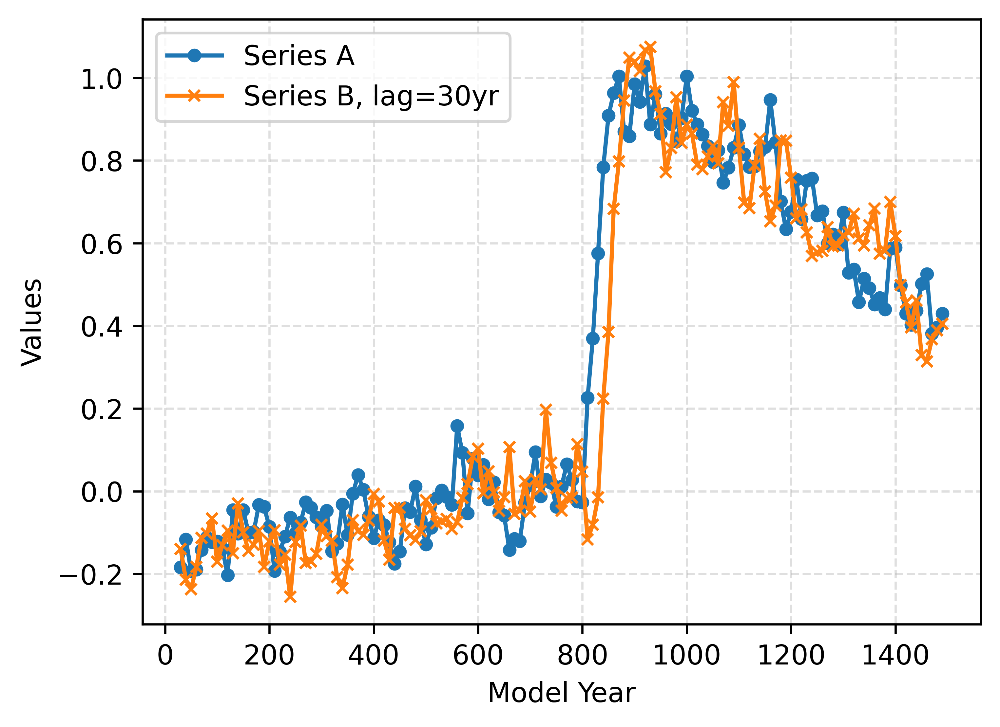

In [2]:
import matplotlib.pyplot as plt


lag=-3
dummy_data = gen_dummy_DO(length=1500, delta=10.0, t0=800.0, dt=56.32925780771254, dy=1.0, GS_slope=0.00016431508734689263, GIS_slope=-0.0009404944834246113, sigma=0.06633234778696487, tau=13.649751415738818)
dummy_warming_lagged = gen_linked_data(dummy_data, causal_strength=1, delta=10.0, lag=lag, tau=13.649751415738818, sigma=0.06633234778696487)


# Enhance the plot
plt.figure(figsize=(5.5, 4),dpi=600)  # Adjust the figure size
plt.plot(dummy_warming_lagged['time'], dummy_warming_lagged['A'], label='Series A', linestyle='-', marker='o', markersize=4)
plt.plot(dummy_warming_lagged['time'], dummy_warming_lagged['B'], label=f'Series B, lag={lag*-10}yr', linestyle='-', marker='x', markersize=4)

# Add grid, title, and labels
plt.grid(True, linestyle='--', alpha=0.4)
# plt.title('Time Series of Dummy Warming Data')
plt.xlabel('Model Year')
plt.ylabel('Values')

# Add legend
plt.legend()

plt.show()


In [3]:
from statsmodels.tsa.stattools import adfuller, grangercausalitytests,kpss

# grangercausalitytests(dummy_warming_lagged[['A', 'B']], 5, verbose=True)
grangercausalitytests(dummy_warming_lagged[['B', 'A']], 5, verbose=True)


Granger Causality
number of lags (no zero) 1
ssr based F test:         F=60.9319 , p=0.0000  , df_denom=143, df_num=1
ssr based chi2 test:   chi2=62.2102 , p=0.0000  , df=1
likelihood ratio test: chi2=51.8215 , p=0.0000  , df=1
parameter F test:         F=60.9319 , p=0.0000  , df_denom=143, df_num=1

Granger Causality
number of lags (no zero) 2
ssr based F test:         F=36.2186 , p=0.0000  , df_denom=140, df_num=2
ssr based chi2 test:   chi2=75.0243 , p=0.0000  , df=2
likelihood ratio test: chi2=60.4656 , p=0.0000  , df=2
parameter F test:         F=36.2186 , p=0.0000  , df_denom=140, df_num=2

Granger Causality
number of lags (no zero) 3
ssr based F test:         F=25.5244 , p=0.0000  , df_denom=137, df_num=3
ssr based chi2 test:   chi2=80.4858 , p=0.0000  , df=3
likelihood ratio test: chi2=63.9359 , p=0.0000  , df=3
parameter F test:         F=25.5244 , p=0.0000  , df_denom=137, df_num=3

Granger Causality
number of lags (no zero) 4
ssr based F test:         F=18.9736 , p=0.0000  

d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\statsmodels\tsa\stattools.py:1545: FutureWarning: verbose is deprecated since functions should not print results
  warnings.warn(


{1: ({'ssr_ftest': (60.9319129811126, 1.1412987535486277e-12, 143.0, 1),
   'ssr_chi2test': (62.210204861835244, 3.0868416543722493e-15, 1),
   'lrtest': (51.82146600472544, 6.078362573032887e-13, 1),
   'params_ftest': (60.93191298111265, 1.1412987535486015e-12, 143.0, 1.0)},
   array([[0., 1., 0.]])]),
 2: ({'ssr_ftest': (36.21861418612077, 2.1029000608138585e-13, 140.0, 2),
   'ssr_chi2test': (75.02427224267873, 5.1131234470091134e-17, 2),
   'lrtest': (60.46559830217143, 7.414163451604804e-14, 2),
   'params_ftest': (36.21861418612066, 2.1029000608139824e-13, 140.0, 2.0)},
   array([[0., 0., 1., 0., 0.],
          [0., 0., 0., 1., 0.]])]),
 3: ({'ssr_ftest': (25.524426284646193, 3.5221956524320807e-13, 137.0, 3),
   'ssr_chi2test': (80.48578215304492, 2.414531570977337e-17, 3),
   'lrtest': (63.93586671849124, 8.471402428214096e-14, 3),
   'params_ftest': (25.52442628464623, 3.5221956524319575e-13, 137.0, 3.0)},
   array([[0., 0., 0., 1., 0., 0., 0.],
          [0., 0., 0., 0., 1.,

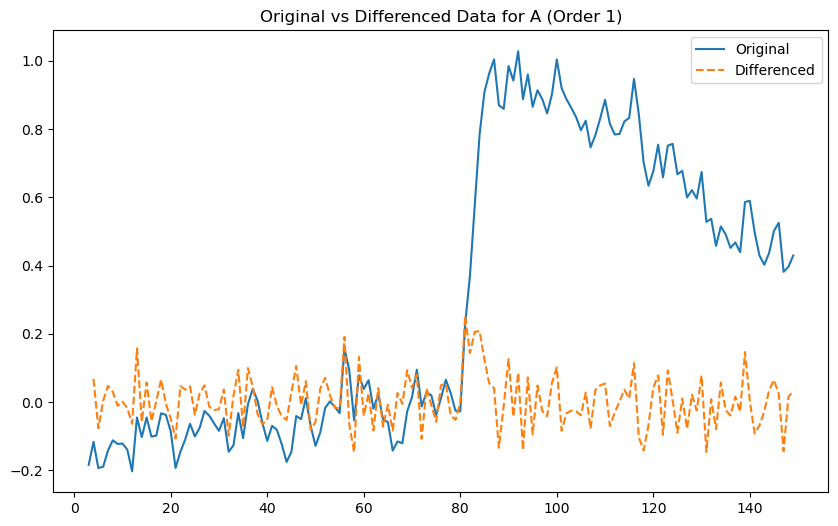

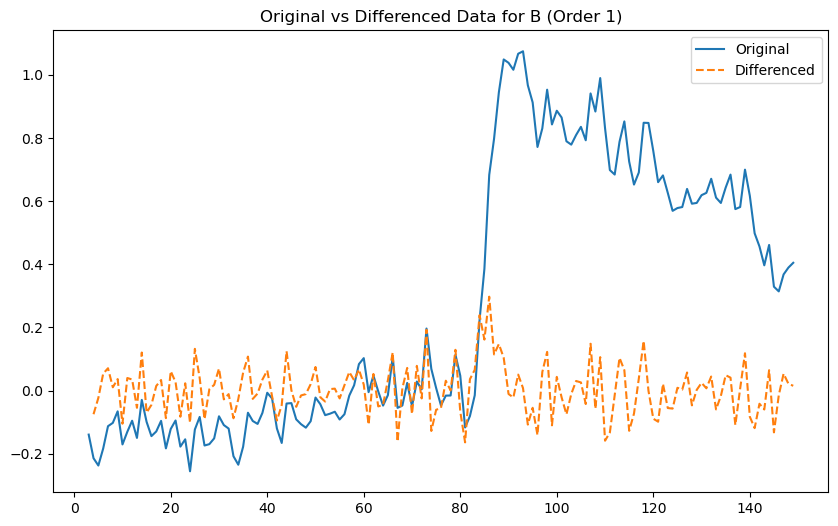

Granger Causality Test
------------------------------------------------------------
Direction                   F-statistics         p-value         lag         Granger cause
A => B    8.500               0.000                6                True
B => A    1.919               0.168                1                False



d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\statsmodels\tsa\stattools.py:1545: FutureWarning: verbose is deprecated since functions should not print results
  warnings.warn(
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\statsmodels\tsa\stattools.py:1545: FutureWarning: verbose is deprecated since functions should not print results
  warnings.warn(


'Granger Causality Test\n------------------------------------------------------------\nDirection                   F-statistics         p-value         lag         Granger cause\nA => B    8.500               0.000                6                True\nB => A    1.919               0.168                1                False\n'

In [4]:
from toolbox import GC_functions as GC
import importlib
importlib.reload(GC)

dummy_warming_lagged_checked = GC.make_stationary(dummy_warming_lagged,['A', 'B'], test_method='ADF', plot=True)
GC.gc_test(dummy_warming_lagged_checked, 'A','B', max_lags=10)

# Red noise, no zscore

In [5]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap
from toolbox import GC_functions as GC  # Assuming GC_functions is your custom module

# Initialize parameters
causal_strengths = np.arange(0.1, 1.1, 0.1)  # From 0.1 to 1.0 in steps of 0.1
lags = range(11)  # From 0 to 10
iterations = 100
causal_AB_results = np.zeros((len(causal_strengths), len(lags)))
causal_BA_results = np.zeros((len(causal_strengths), len(lags)))

# Loop through combinations of causal strengths and lags
for i, strength in enumerate(causal_strengths):
    for j, lag in enumerate(lags):
        causal_AB_true_count = 0
        causal_BA_true_count = 0
        
        for _ in range(iterations):
            # Generate dummy data and linked data
            dummy_data = gen_dummy_DO(length=1500, delta=10.0, t0=800.0, dt=56.32925780771254, dy=1.0, GS_slope=0.00016431508734689263, GIS_slope=-0.0009404944834246113, sigma=0.06633234778696487, tau=13.649751415738818)
            dummy_warming_lagged = gen_linked_data(dummy_data, causal_strength=strength, delta=10.0, lag=lag, tau=13.649751415738818, sigma=0.06633234778696487)
            
            df_gc = dummy_warming_lagged[['A', 'B']]
            
            df_gc_checked = GC.make_stationary(df_gc,['A', 'B'], test_method='ADF', plot=False)
            gc_results_A_B = GC.gc4vars(df_gc_checked, max_lags=19, print_results=False)
            causal_AB = gc_results_A_B[0]['XY']
            causal_BA = gc_results_A_B[0]['YX']
            
            if causal_AB:
                causal_AB_true_count += 1
            if causal_BA:
                causal_BA_true_count += 1
        
        # Calculate the percentages
        causal_AB_results[i, j] = causal_AB_true_count / iterations
        causal_BA_results[i, j] = causal_BA_true_count / iterations

        causal_AB_results[i, j]  = causal_AB_results[i, j]  >= 0.95
        causal_BA_results[i, j] = causal_BA_results[i, j] >= 0.95


causal_results_red_nozscore = np.where((causal_AB_results == 1) & (causal_BA_results == 0), 1, 0)



d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\statsmodels\tsa\stattools.py:1545: FutureWarning: verbose is deprecated since functions should not print results
  warnings.warn(
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\statsmodels\tsa\stattools.py:1545: FutureWarning: verbose is deprecated since functions should not print results
  warnings.warn(
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\statsmodels\tsa\stattools.py:1545: FutureWarning: verbose is deprecated since functions should not print results
  warnings.warn(
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\statsmodels\tsa\stattools.py:1545: FutureWarning: verbose is deprecated since functions should not print results
  warnings.warn(
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\statsmodels\tsa\stattools.py:1545: FutureWarning: verbose is deprecated since functions should not print results
  warnings.warn(
d:\Users\User\anaconda3\envs\pz_venv_cau

In [7]:
# save the results to D:\VScode\Paleoclimate_causality\syth_test_results
np.save('D:\\VScode\\Paleoclimate_causality\\syth_test_results\\causal_AB_results_oneways_GC.npy', causal_AB_results)
np.save('D:\\VScode\\Paleoclimate_causality\\syth_test_results\\causal_BA_results_oneways_GC.npy', causal_BA_results)
np.save('D:\\VScode\\Paleoclimate_causality\\syth_test_results\\causal_results_red_nozscore_oneways_GC.npy', causal_results_red_nozscore)

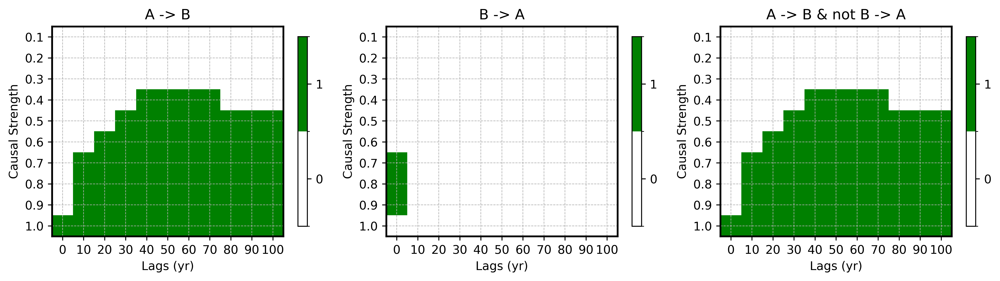

In [6]:
from toolbox import syth_ana_functions as saf



fig, axs = plt.subplots(1, 3, figsize=(12, 4), dpi=600)  # 1 row, 3 columns of plots

# Plot each of the causal matrices with text annotations
saf.causal_matshow_ax(causal_AB_results, axs[0], title='A -> B')
saf.causal_matshow_ax(causal_BA_results, axs[1], title='B -> A')

# Assuming causal_results_red_nozscore is derived in your existing code
saf.causal_matshow_ax(causal_results_red_nozscore, axs[2], title='A -> B & not B -> A')

plt.tight_layout()
plt.show()

In [17]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap
from toolbox import GC_functions as GC  # Assuming GC_functions is your custom module

# Initialize parameters
causal_strengths = np.arange(0.1, 1.1, 0.1)  # From 0.1 to 1.0 in steps of 0.1
lags = range(11)  # From 0 to 10
iterations = 100
causal_AB_results = np.zeros((len(causal_strengths), len(lags)))
causal_BA_results = np.zeros((len(causal_strengths), len(lags)))

# Loop through combinations of causal strengths and lags
for i, strength in enumerate(causal_strengths):
    for j, lag in enumerate(lags):
        causal_AB_true_count = 0
        causal_BA_true_count = 0
        
        for _ in range(iterations):
            # Generate dummy data and linked data
            dummy_data = gen_dummy_DO(length=1500, delta=10.0, t0=800.0, dt=56.32925780771254, dy=1.0, GS_slope=0.00016431508734689263, GIS_slope=-0.0009404944834246113, sigma=0.06633234778696487, tau=13.649751415738818)
            dummy_warming_lagged = gen_linked_data(dummy_data, causal_strength=strength, delta=10.0, lag=lag, tau=13.649751415738818, sigma=0.06633234778696487)
            
            df_gc = dummy_warming_lagged[['A', 'B']]
            
            df_gc_checked = GC.make_stationary(df_gc,['A', 'B'], test_method='ADF', plot=False)
            gc_results_A_B = GC.gc4vars(df_gc_checked, max_lags=19, print_results=False)
            causal_AB = gc_results_A_B[0]['XY']
            causal_BA = gc_results_A_B[0]['YX']
            
            if causal_AB:
                causal_AB_true_count += 1
            if causal_BA:
                causal_BA_true_count += 1
        
        # Calculate the percentages
        causal_AB_results[i, j] = causal_AB_true_count / iterations
        causal_BA_results[i, j] = causal_BA_true_count / iterations

        causal_AB_results[i, j]  = causal_AB_results[i, j]  >= 0.95
        causal_BA_results[i, j] = causal_BA_results[i, j] >= 0.95


causal_results_red_nozscore = np.where((causal_AB_results == 1) & (causal_BA_results == 0), 1, 0)

# 2. Save the `causal_results` as a .npy file
np.save('D:/VScode/Paleoclimate_causality/data/causal_test_on_dummy_data/causal_results_red_nozscore.npy', causal_results_red_nozscore)

d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\statsmodels\tsa\stattools.py:1545: FutureWarning: verbose is deprecated since functions should not print results
  warnings.warn(
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\statsmodels\tsa\stattools.py:1545: FutureWarning: verbose is deprecated since functions should not print results
  warnings.warn(
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\statsmodels\tsa\stattools.py:1545: FutureWarning: verbose is deprecated since functions should not print results
  warnings.warn(
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\statsmodels\tsa\stattools.py:1545: FutureWarning: verbose is deprecated since functions should not print results
  warnings.warn(
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\statsmodels\tsa\stattools.py:1545: FutureWarning: verbose is deprecated since functions should not print results
  warnings.warn(
d:\Users\User\anaconda3\envs\pz_venv_cau

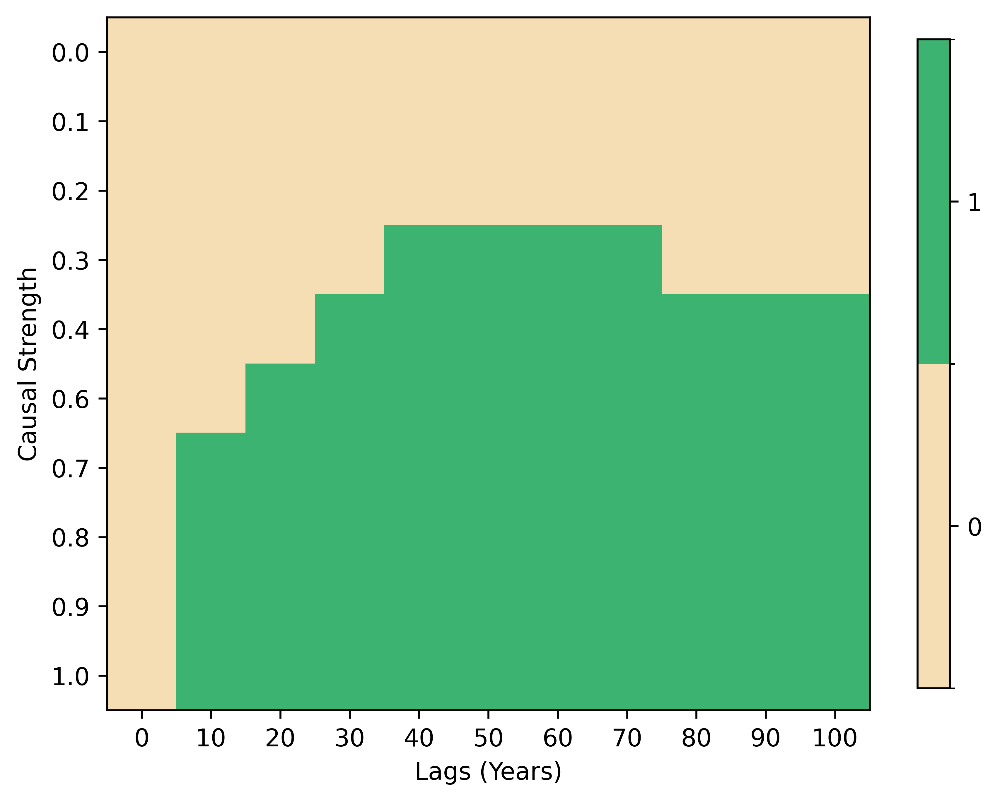

In [18]:
# read the file
causal_results_red_nozscore = np.load('D:/VScode/Paleoclimate_causality/data/causal_test_on_dummy_data/causal_results_red_nozscore.npy')
causal_matshow(causal_results_red_nozscore)

# Red noise, zscore

d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\statsmodels\tsa\stattools.py:1545: FutureWarning: verbose is deprecated since functions should not print results
  warnings.warn(
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\statsmodels\tsa\stattools.py:1545: FutureWarning: verbose is deprecated since functions should not print results
  warnings.warn(


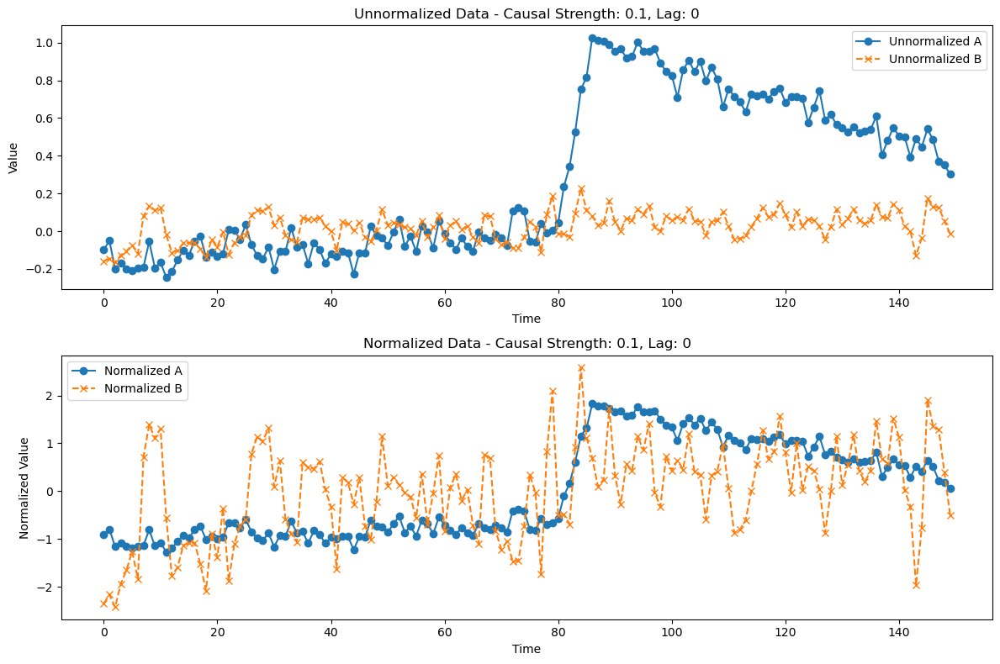

d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\statsmodels\tsa\stattools.py:1545: FutureWarning: verbose is deprecated since functions should not print results
  warnings.warn(
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\statsmodels\tsa\stattools.py:1545: FutureWarning: verbose is deprecated since functions should not print results
  warnings.warn(
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\statsmodels\tsa\stattools.py:1545: FutureWarning: verbose is deprecated since functions should not print results
  warnings.warn(
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\statsmodels\tsa\stattools.py:1545: FutureWarning: verbose is deprecated since functions should not print results
  warnings.warn(
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\statsmodels\tsa\stattools.py:1545: FutureWarning: verbose is deprecated since functions should not print results
  warnings.warn(
d:\Users\User\anaconda3\envs\pz_venv_cau

In [19]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap
from toolbox import GC_functions as GC  # Assuming GC_functions is your custom module

# Initialize parameters
causal_strengths = np.arange(0.1, 1.1, 0.1)  # From 0.1 to 1.0 in steps of 0.1
lags = range(11)  # From 0 to 10
iterations = 100
causal_AB_results = np.zeros((len(causal_strengths), len(lags)))
causal_BA_results = np.zeros((len(causal_strengths), len(lags)))

if_plot=0
# Loop through combinations of causal strengths and lags
for i, strength in enumerate(causal_strengths):
    for j, lag in enumerate(lags):
        causal_AB_true_count = 0
        causal_BA_true_count = 0
        
        for iteration in range(iterations):
            # Generate dummy data and linked data
            dummy_data = gen_dummy_DO(length=1500, delta=10.0, t0=800.0, dt=56.32925780771254, dy=1.0, GS_slope=0.00016431508734689263, GIS_slope=-0.0009404944834246113, sigma=0.06633234778696487, tau=13.649751415738818)
            dummy_warming_lagged = gen_linked_data(dummy_data, causal_strength=strength, delta=10.0, lag=lag, tau=13.649751415738818, sigma=0.06633234778696487)
            
            df_gc = dummy_warming_lagged[['A', 'B']].copy()  # Use copy to avoid SettingWithCopyWarning
            df_gc_normalized = df_gc.copy()
            df_gc_normalized['A'] = (df_gc_normalized['A'] - df_gc_normalized['A'].mean()) / df_gc_normalized['A'].std()
            df_gc_normalized['B'] = (df_gc_normalized['B'] - df_gc_normalized['B'].mean()) / df_gc_normalized['B'].std()
            
            df_gc_checked = GC.make_stationary(df_gc_normalized, ['A', 'B'], test_method='ADF', plot=False)
            gc_results_A_B = GC.gc4vars(df_gc_checked, max_lags=19, print_results=False)
            causal_AB = gc_results_A_B[0]['XY']
            causal_BA = gc_results_A_B[0]['YX']
            
            if causal_AB:
                causal_AB_true_count += 1
            if causal_BA:
                causal_BA_true_count += 1

            # Plotting in the first iteration of each combination
            if iteration == 0 and if_plot==0:
                plt.figure(figsize=(12, 8))

                # Plot unnormalized data
                plt.subplot(2, 1, 1)  # 2 rows, 1 column, 1st subplot
                plt.plot(df_gc['A'], label='Unnormalized A', linestyle='-', marker='o')
                plt.plot(df_gc['B'], label='Unnormalized B', linestyle='--', marker='x')
                plt.title(f'Unnormalized Data - Causal Strength: {strength}, Lag: {lag}')
                plt.xlabel('Time')
                plt.ylabel('Value')
                plt.legend()

                # Plot normalized data
                plt.subplot(2, 1, 2)  # 2 rows, 1 column, 2nd subplot
                plt.plot(df_gc_normalized['A'], label='Normalized A', linestyle='-', marker='o')
                plt.plot(df_gc_normalized['B'], label='Normalized B', linestyle='--', marker='x')
                plt.title(f'Normalized Data - Causal Strength: {strength}, Lag: {lag}')
                plt.xlabel('Time')
                plt.ylabel('Normalized Value')
                plt.legend()

                plt.tight_layout()
                plt.show()
                if_plot=1
        
        # Calculate the percentages
        causal_AB_results[i, j] = causal_AB_true_count / iterations
        causal_BA_results[i, j] = causal_BA_true_count / iterations

        causal_AB_results[i, j] = causal_AB_results[i, j] >= 0.95
        causal_BA_results[i, j] = causal_BA_results[i, j] >= 0.95

causal_results_red_zscore = np.where((causal_AB_results == 1) & (causal_BA_results == 0), 1, 0)

# 2. Save the `causal_results` as a .npy file
np.save('D:/VScode/Paleoclimate_causality/data/causal_test_on_dummy_data/causal_results_red_zscore.npy', causal_results_red_zscore)

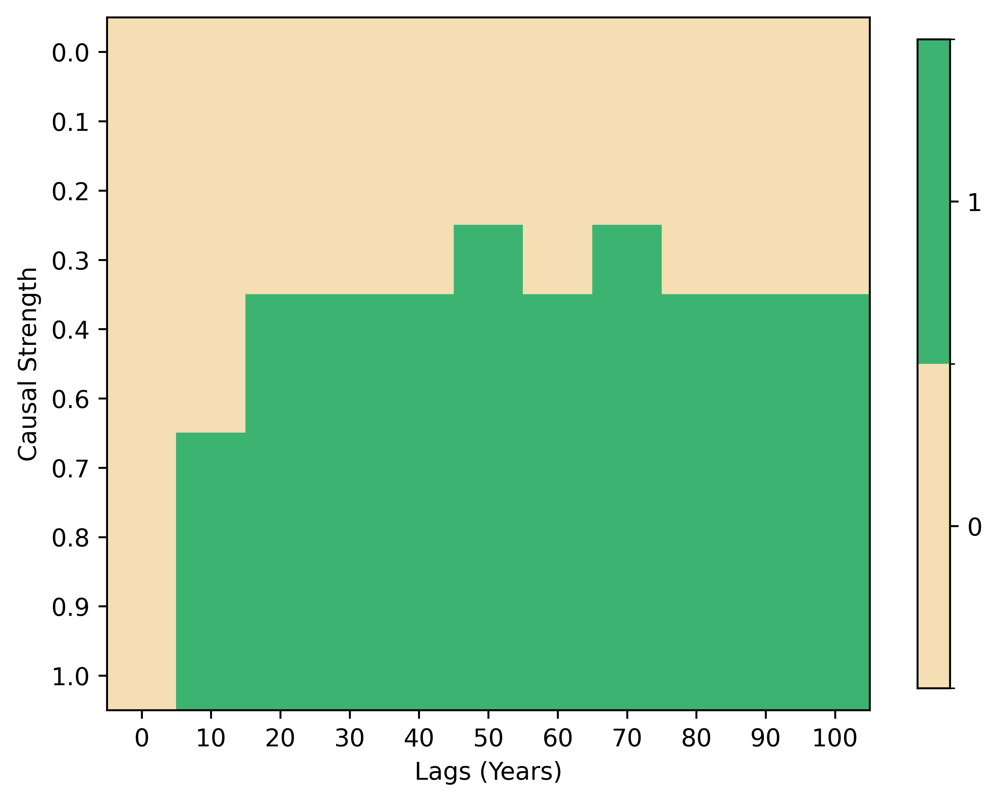

In [20]:
# read the file
causal_results_red_zscore = np.load('D:/VScode/Paleoclimate_causality/data/causal_test_on_dummy_data/causal_results_red_zscore.npy')
causal_matshow(causal_results_red_zscore)

# White noise, No zscore

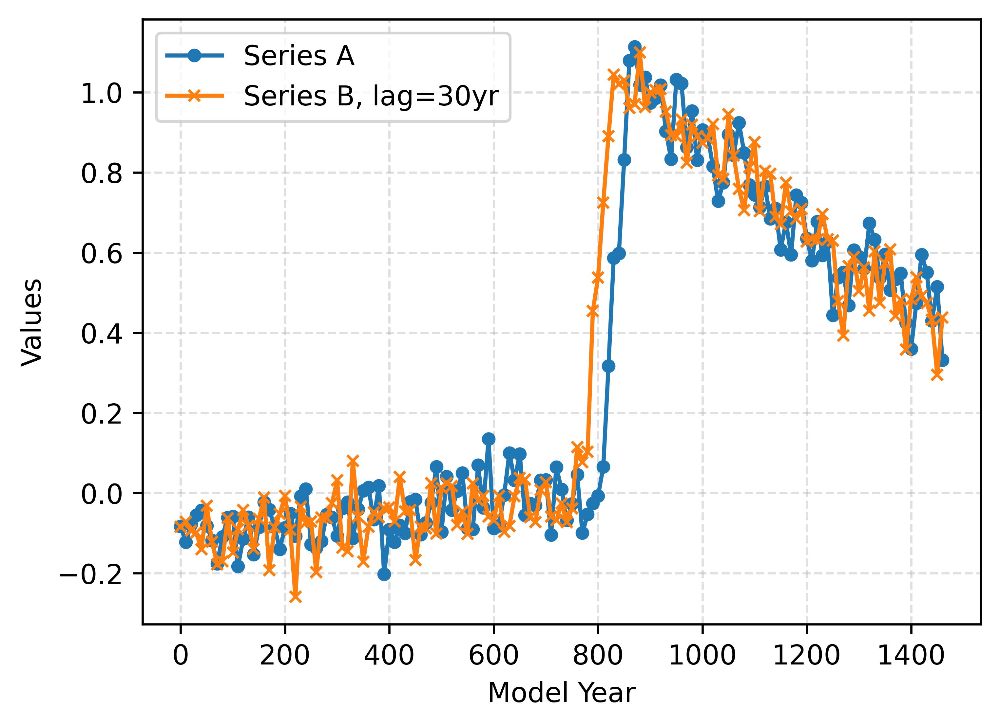

In [21]:
import matplotlib.pyplot as plt



lag=3
dummy_data = gen_dummy_DO_white(length=1500, delta=10.0, t0=800.0, dt=56.32925780771254, dy=1.0, GS_slope=0.00016431508734689263, GIS_slope=-0.0009404944834246113, sigma=0.06633234778696487)
dummy_warming_lagged = gen_linked_data_white(dummy_data, causal_strength=1, delta=10.0, lag=lag, sigma=0.06633234778696487)


# Enhance the plot
plt.figure(figsize=(5.5, 4),dpi=600)  # Adjust the figure size
plt.plot(dummy_warming_lagged['time'], dummy_warming_lagged['A'], label='Series A', linestyle='-', marker='o', markersize=4)
plt.plot(dummy_warming_lagged['time'], dummy_warming_lagged['B'], label=f'Series B, lag={lag*10}yr', linestyle='-', marker='x', markersize=4)

# Add grid, title, and labels
plt.grid(True, linestyle='--', alpha=0.4)
# plt.title('Time Series of Dummy Warming Data')
plt.xlabel('Model Year')
plt.ylabel('Values')

# Add legend
plt.legend()

plt.show()


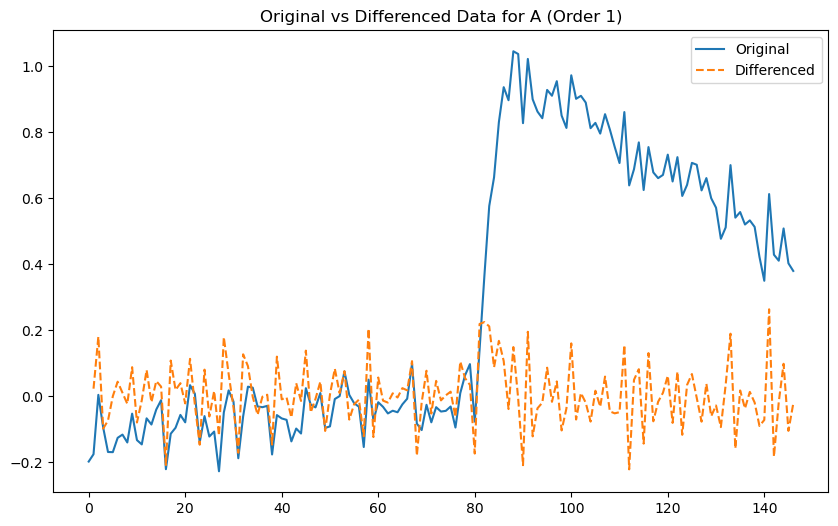

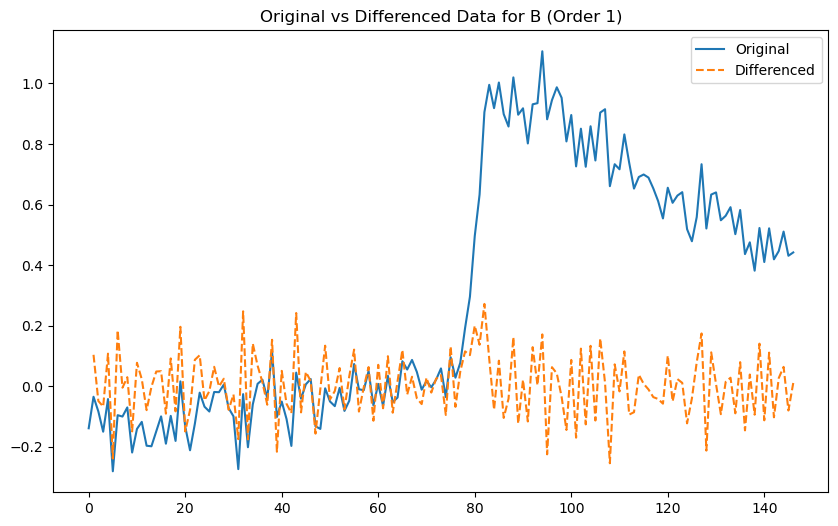

Granger Causality Test
------------------------------------------------------------
Direction                   F-statistics         p-value         lag         Granger cause
A => B    6.576               0.000                7                True
B => A    1.468               0.117                19                False



d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\statsmodels\tsa\stattools.py:1545: FutureWarning: verbose is deprecated since functions should not print results
  warnings.warn(
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\statsmodels\tsa\stattools.py:1545: FutureWarning: verbose is deprecated since functions should not print results
  warnings.warn(


'Granger Causality Test\n------------------------------------------------------------\nDirection                   F-statistics         p-value         lag         Granger cause\nA => B    6.576               0.000                7                True\nB => A    1.468               0.117                19                False\n'

In [13]:
from toolbox import GC_functions as GC
dummy_warming_lagged_checked = GC.make_stationary(dummy_warming_lagged,['A', 'B'], test_method='ADF', plot=True)
GC.gc_test(dummy_warming_lagged_checked, 'A','B', max_lags=30)

In [22]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap
from toolbox import GC_functions as GC  # Assuming GC_functions is your custom module

# Initialize parameters
causal_strengths = np.arange(0.1, 1.1, 0.1)  # From 0.1 to 1.0 in steps of 0.1
lags = range(11)  # From 0 to 10
iterations = 100
causal_AB_results = np.zeros((len(causal_strengths), len(lags)))
causal_BA_results = np.zeros((len(causal_strengths), len(lags)))

# Loop through combinations of causal strengths and lags
for i, strength in enumerate(causal_strengths):
    for j, lag in enumerate(lags):
        causal_AB_true_count = 0
        causal_BA_true_count = 0
        
        for _ in range(iterations):
            # Generate dummy data and linked data
            dummy_data = gen_dummy_DO_white(length=1500, delta=10.0, t0=800.0, dt=56.32925780771254, dy=1.0, GS_slope=0.00016431508734689263, GIS_slope=-0.0009404944834246113, sigma=0.06633234778696487)
            dummy_warming_lagged = gen_linked_data_white(dummy_data, causal_strength=strength, delta=10.0, lag=lag, sigma=0.06633234778696487)
            
            df_gc = dummy_warming_lagged[['A', 'B']]
            
            df_gc_checked = GC.make_stationary(df_gc,['A', 'B'], test_method='ADF', plot=False)
            gc_results_A_B = GC.gc4vars(df_gc_checked, max_lags=19, print_results=False)
            causal_AB = gc_results_A_B[0]['XY']
            causal_BA = gc_results_A_B[0]['YX']
            
            if causal_AB:
                causal_AB_true_count += 1
            if causal_BA:
                causal_BA_true_count += 1
        
        # Calculate the percentages
        causal_AB_results[i, j] = causal_AB_true_count / iterations
        causal_BA_results[i, j] = causal_BA_true_count / iterations

        causal_AB_results[i, j]  = causal_AB_results[i, j]  >= 0.95
        causal_BA_results[i, j] = causal_BA_results[i, j] >= 0.95


causal_results_white_nozscore = np.where((causal_AB_results == 1) & (causal_BA_results == 0), 1, 0)
# 2. Save the `causal_results` as a .npy file
np.save('D:/VScode/Paleoclimate_causality/data/causal_test_on_dummy_data/causal_results_white_nozscore.npy', causal_results_white_nozscore)

d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\statsmodels\tsa\stattools.py:1545: FutureWarning: verbose is deprecated since functions should not print results
  warnings.warn(
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\statsmodels\tsa\stattools.py:1545: FutureWarning: verbose is deprecated since functions should not print results
  warnings.warn(
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\statsmodels\tsa\stattools.py:1545: FutureWarning: verbose is deprecated since functions should not print results
  warnings.warn(
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\statsmodels\tsa\stattools.py:1545: FutureWarning: verbose is deprecated since functions should not print results
  warnings.warn(
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\statsmodels\tsa\stattools.py:1545: FutureWarning: verbose is deprecated since functions should not print results
  warnings.warn(
d:\Users\User\anaconda3\envs\pz_venv_cau

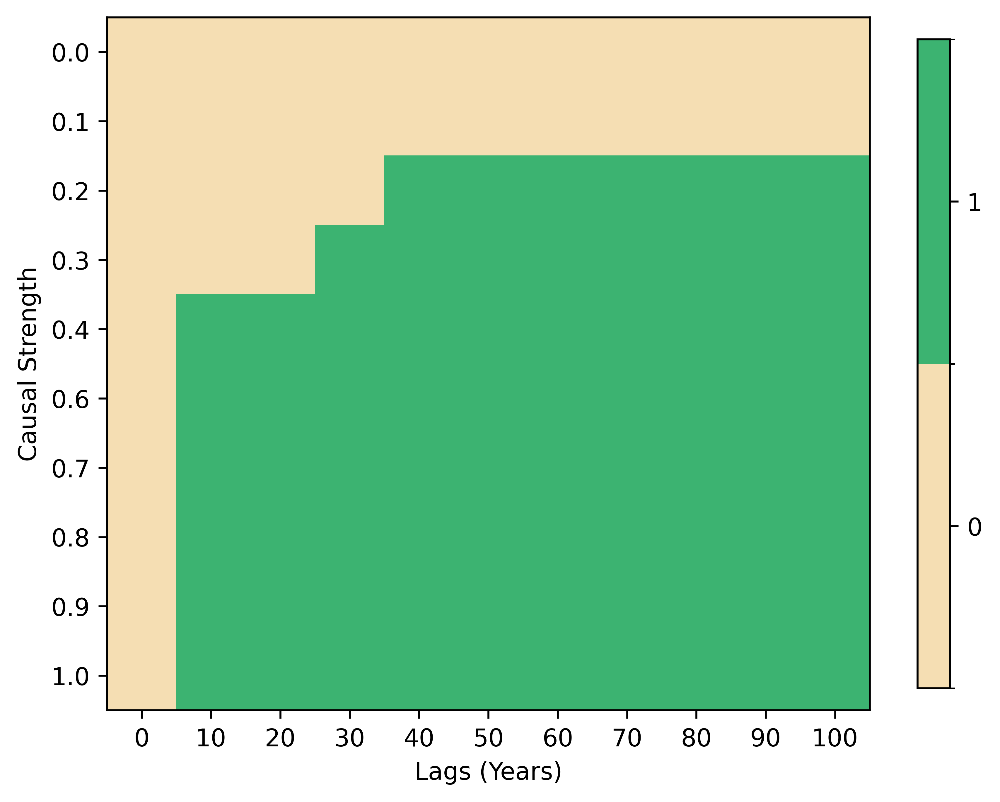

In [23]:
# read the file
causal_results_white_nozscore = np.load('D:/VScode/Paleoclimate_causality/data/causal_test_on_dummy_data/causal_results_white_nozscore.npy')
causal_matshow(causal_results_white_nozscore)

# White noise zscore

d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\statsmodels\tsa\stattools.py:1545: FutureWarning: verbose is deprecated since functions should not print results
  warnings.warn(
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\statsmodels\tsa\stattools.py:1545: FutureWarning: verbose is deprecated since functions should not print results
  warnings.warn(


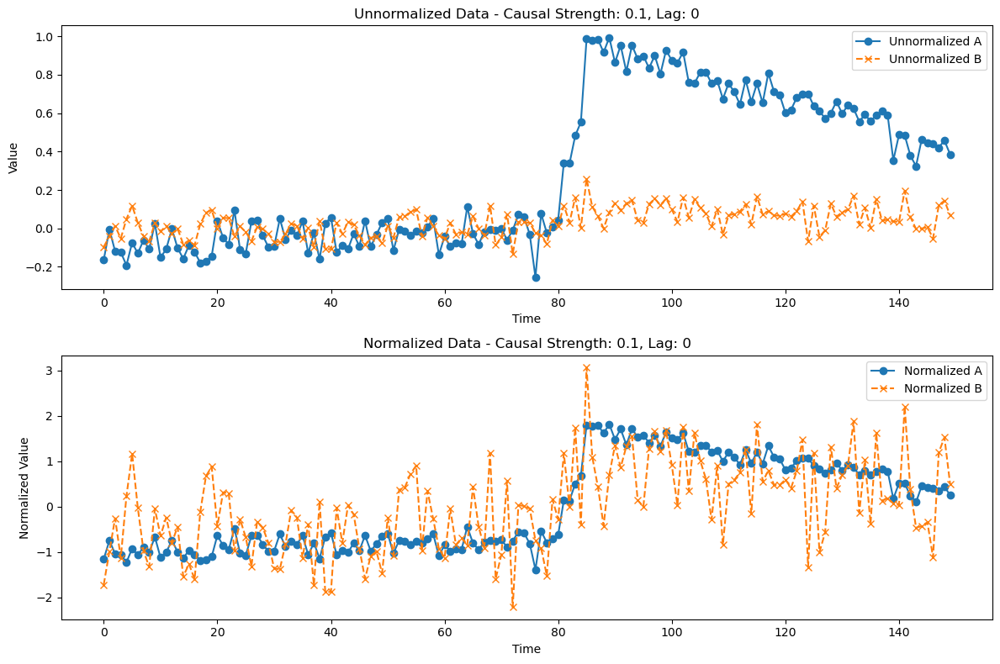

d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\statsmodels\tsa\stattools.py:1545: FutureWarning: verbose is deprecated since functions should not print results
  warnings.warn(
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\statsmodels\tsa\stattools.py:1545: FutureWarning: verbose is deprecated since functions should not print results
  warnings.warn(
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\statsmodels\tsa\stattools.py:1545: FutureWarning: verbose is deprecated since functions should not print results
  warnings.warn(
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\statsmodels\tsa\stattools.py:1545: FutureWarning: verbose is deprecated since functions should not print results
  warnings.warn(
d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\statsmodels\tsa\stattools.py:1545: FutureWarning: verbose is deprecated since functions should not print results
  warnings.warn(
d:\Users\User\anaconda3\envs\pz_venv_cau

In [24]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap
from toolbox import GC_functions as GC  # Assuming GC_functions is your custom module

# Initialize parameters
causal_strengths = np.arange(0.1, 1.1, 0.1)  # From 0.1 to 1.0 in steps of 0.1
lags = range(11)  # From 0 to 10
iterations = 100
causal_AB_results = np.zeros((len(causal_strengths), len(lags)))
causal_BA_results = np.zeros((len(causal_strengths), len(lags)))

if_plot=0
# Loop through combinations of causal strengths and lags
for i, strength in enumerate(causal_strengths):
    for j, lag in enumerate(lags):
        causal_AB_true_count = 0
        causal_BA_true_count = 0
        
        for iteration in range(iterations):
            # Generate dummy data and linked data
            dummy_data = gen_dummy_DO_white(length=1500, delta=10.0, t0=800.0, dt=56.32925780771254, dy=1.0, GS_slope=0.00016431508734689263, GIS_slope=-0.0009404944834246113, sigma=0.06633234778696487)
            dummy_warming_lagged = gen_linked_data_white(dummy_data, causal_strength=strength, delta=10.0, lag=lag,  sigma=0.06633234778696487)
            
            df_gc = dummy_warming_lagged[['A', 'B']].copy()  # Use copy to avoid SettingWithCopyWarning
            df_gc_normalized = df_gc.copy()
            df_gc_normalized['A'] = (df_gc_normalized['A'] - df_gc_normalized['A'].mean()) / df_gc_normalized['A'].std()
            df_gc_normalized['B'] = (df_gc_normalized['B'] - df_gc_normalized['B'].mean()) / df_gc_normalized['B'].std()
            
            df_gc_checked = GC.make_stationary(df_gc_normalized, ['A', 'B'], test_method='ADF', plot=False)
            gc_results_A_B = GC.gc4vars(df_gc_checked, max_lags=19, print_results=False)
            causal_AB = gc_results_A_B[0]['XY']
            causal_BA = gc_results_A_B[0]['YX']
            
            if causal_AB:
                causal_AB_true_count += 1
            if causal_BA:
                causal_BA_true_count += 1

            # Plotting in the first iteration of each combination
            if iteration == 0 and if_plot==0:
                plt.figure(figsize=(12, 8))

                # Plot unnormalized data
                plt.subplot(2, 1, 1)  # 2 rows, 1 column, 1st subplot
                plt.plot(df_gc['A'], label='Unnormalized A', linestyle='-', marker='o')
                plt.plot(df_gc['B'], label='Unnormalized B', linestyle='--', marker='x')
                plt.title(f'Unnormalized Data - Causal Strength: {strength}, Lag: {lag}')
                plt.xlabel('Time')
                plt.ylabel('Value')
                plt.legend()

                # Plot normalized data
                plt.subplot(2, 1, 2)  # 2 rows, 1 column, 2nd subplot
                plt.plot(df_gc_normalized['A'], label='Normalized A', linestyle='-', marker='o')
                plt.plot(df_gc_normalized['B'], label='Normalized B', linestyle='--', marker='x')
                plt.title(f'Normalized Data - Causal Strength: {strength}, Lag: {lag}')
                plt.xlabel('Time')
                plt.ylabel('Normalized Value')
                plt.legend()

                plt.tight_layout()
                plt.show()
                if_plot=1
        
        # Calculate the percentages
        causal_AB_results[i, j] = causal_AB_true_count / iterations
        causal_BA_results[i, j] = causal_BA_true_count / iterations

        causal_AB_results[i, j] = causal_AB_results[i, j] >= 0.95
        causal_BA_results[i, j] = causal_BA_results[i, j] >= 0.95

causal_results_white_zscore = np.where((causal_AB_results == 1) & (causal_BA_results == 0), 1, 0)
# 2. Save the `causal_results` as a .npy file
np.save('D:/VScode/Paleoclimate_causality/data/causal_test_on_dummy_data/causal_results_white_zscore.npy', causal_results_white_zscore)


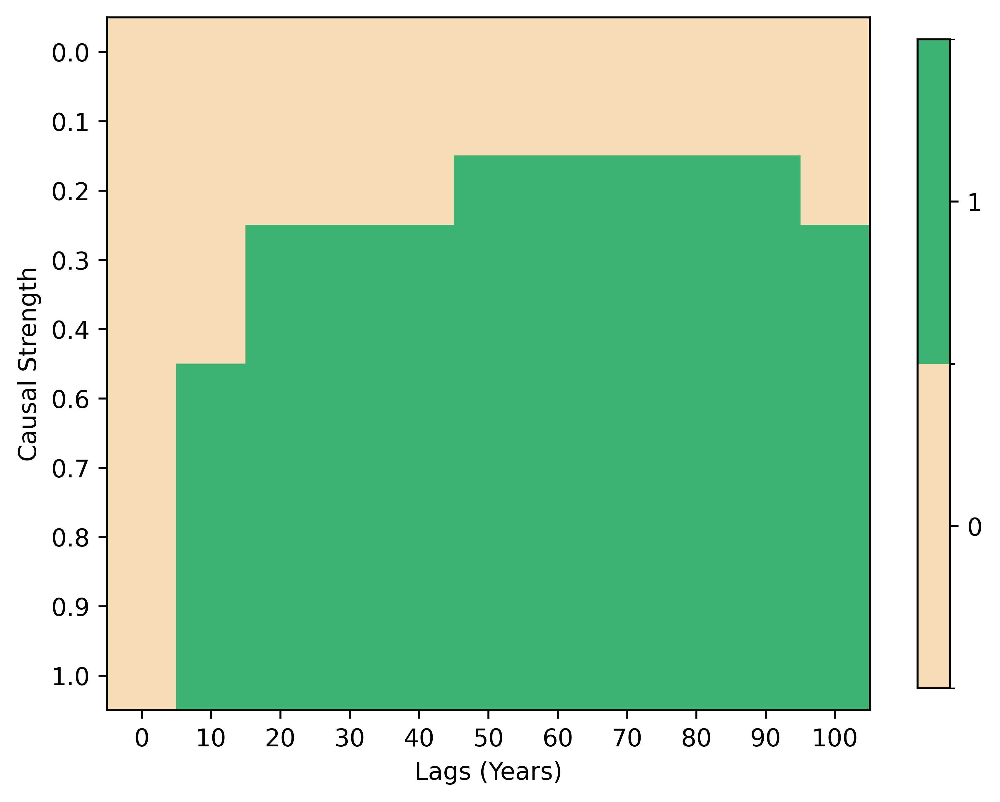

In [25]:
# read the file
causal_results_white_zscore = np.load('D:/VScode/Paleoclimate_causality/data/causal_test_on_dummy_data/causal_results_white_zscore.npy')
causal_matshow(causal_results_white_zscore)